In [55]:
import os
import PyPDF2
import fitz
import pandas as pd
import collections
import re

In [56]:
from nltk import tokenize
# import nltk
# nltk.download('punkt')

In [57]:
dir = 'annoted_sustainability_reports/Consumer_Discretionary/'

In [58]:
x_label = ["McDonalds", "TJX", "HomeDepot", "Lowes", "Target", "BookingHoldings", "Tesla","Amazon", "Nike", "Starbucks"]

### Extracting Sentences: Refined Version

In [59]:
# this method will return a list of highlighted sentences in each page 
def get_page_highlights_coord(annot):
    page_highlights_coord = []
    while annot:
        if annot.type[0] == 8:
            all_coordinates = annot.vertices
            try:
                if len(all_coordinates) == 4:
                    highlight_coord = fitz.Quad(all_coordinates).rect
                    page_highlights_coord.append(highlight_coord)
                else:
                    all_coordinates = [all_coordinates[x:x+4] for x in range(0, len(all_coordinates), 4)]
                    for i in range(0,len(all_coordinates)):
                        coord = fitz.Quad(all_coordinates[i]).rect
                        page_highlights_coord.append(coord)
            except:
                print("NoneType found")
        annot = annot.next
    return page_highlights_coord
        

In [60]:
def get_page_highlights_text(page_highlights_coord, all_words, test_pos, repeat_coord):
    page_highlights = collections.defaultdict(list)
    for h in page_highlights_coord:
        test_dict = collections.defaultdict(list) # intialize a dictionary that keeps order and 
        # indication of where the sentence breaks occur
        for w in all_words:
            if (fitz.Rect(w[0:4]).intersects(h)): 
            # find intersections where the original report overlaps with the highlighted sentences
                new_pos = int(str("%02d" % w[5]) + str("%02d" % w[6]) + str("%02d" % w[7])) 
#                 print(new_pos, w[4])
                if new_pos not in repeat_coord:
                    repeat_coord.append(new_pos)
                    if test_pos <  new_pos:
#                         print('less than', test_pos, new_pos, w[4]) 
                        test_pos = new_pos 
                        test_dict[new_pos].append(w[4])
                        page_highlights[new_pos].append(test_dict[new_pos][0])
#                         page_highlights.append({new_pos : test_dict[new_pos]})
                    else:
#                         print('greater than', test_pos, new_pos, w[4])
                        test_dict = collections.defaultdict(list)
                        test_pos = 0
                        test_dict[new_pos].append(w[4])
                        page_highlights[new_pos].append(test_dict[new_pos][0])
#                         page_highlights.append({new_pos : test_dict[new_pos]})
                else:
                    continue
    return page_highlights
                    

In [61]:
def get_total_highlights_text(total_page_highlights):
    total_page_highlights_text = []
    for i in total_page_highlights:
        highlights = ""
        sorted_dict = sorted(i.items(), key = lambda kv:kv[0], reverse = False)
        for k in sorted_dict:
            highlights += k[1][0] + " "
            
        total_page_highlights_text.append(highlights)
    
    return total_page_highlights_text

In [62]:
def make_text(words):
    """Return textstring output of getText("words").

    Word items are sorted for reading sequence left to right,
    top to bottom.
    """
    line_dict = {}  # key: vertical coordinate, value: list of words
    words.sort(key=lambda w: w[0])  # sort by horizontal coordinate
    for w in words:  # fill the line dictionary
        y1 = round(w[3], 0)  # bottom of a word: don't be too picky!
        word = w[4]  # the text of the word
        line = line_dict.get(y1, [])  # read current line content
        line.append(word)  # append new word
        line_dict[y1] = line  # write back to dict
    lines = list(line_dict.items())
    lines.sort()  # sort vertically
    return "\n".join([" ".join(line[1]) for line in lines])

In [63]:
import pdftotext

In [64]:
# Get ALL SENTENCES using the pdftotext package:

all_result_refined = []
all_comp_refined = []

# running all the files in the industry folder
for file in os.listdir(dir): 

    # f = filename + directory
    f = os.path.join(dir, file) 
    print(f)
    
    comp_lab = list(filter(lambda x:  x in f, x_label))
    print(comp_lab)

    with open(f, "rb") as output:
        pdf = pdftotext.PDF(output)

        # Read all the text into one string
        pdftotext_text = " ".join(pdf)
        
    for sent in tokenize.sent_tokenize(pdftotext_text):
        for within_sent in sent.split('\n\n'):
            all_result_refined.append(within_sent)
            all_comp_refined.append(comp_lab[0])


annoted_sustainability_reports/Consumer_Discretionary/McDonalds_2021_Climate_report.pdf
['McDonalds']
annoted_sustainability_reports/Consumer_Discretionary/TJX_2021_Sustainability_report.pdf
['TJX']
annoted_sustainability_reports/Consumer_Discretionary/HomeDepot_2021_ESG_report.pdf
['HomeDepot']
annoted_sustainability_reports/Consumer_Discretionary/Lowes_2021_CSR_report.pdf
['Lowes']
annoted_sustainability_reports/Consumer_Discretionary/Target_2021_Corporate_Responsibility_report.pdf
['Target']
annoted_sustainability_reports/Consumer_Discretionary/BookingHoldings_2021_Sustainability_report.pdf
['BookingHoldings']
annoted_sustainability_reports/Consumer_Discretionary/Tesla_2021_Impact_report.pdf
['Tesla']
annoted_sustainability_reports/Consumer_Discretionary/Amazon_2021_sustainability_report.pdf
['Amazon']
annoted_sustainability_reports/Consumer_Discretionary/Nike_2021_Impact_report.pdf
['Nike']
annoted_sustainability_reports/Consumer_Discretionary/Starbucks_2021_Global_Environmental_an

In [65]:
len(all_result_refined)

34084

In [66]:
for i in range(len(all_result_refined)):
    all_result_refined[i] = re.sub("\n", " ", all_result_refined[i])
    all_result_refined[i] = re.sub("\x0c", "", all_result_refined[i])
    all_result_refined[i] = re.sub("\x07", "", all_result_refined[i])

In [67]:
from random import sample

In [68]:
sample(all_result_refined, 10)

['PROGRESS',
 'To maximize our impact, we plan to continue increasing our production volumes and the accessibility of our products.',
 'Glencore Kamoto Copper Company',
 '2021 ESG Report',
 'Verification Assessments: Where issues are identified, suppliers must develop a corrective action plan detailing actions to address identified issues, a long-term plan to prevent reoccurrence, and where necessary, undergo a follow-up assessment to ensure issues are properly remediated (20% of assessments conducted in 2020 were Verification Assessments).',
 'Within BIPOC representation: 8% of partners identify as Black; 29% Hispanic or Latinx; 6% Asian; 5% Multiracial; 1% American Indian or Alaskan Native and 0.5% Native Hawiian or other Pacific Islander',
 'I believe a company can only make transformative progress when it measures performance.',
 'Team Depot, our associate volunteer force, provides hands-on project support to further the Foundation’s mission and impact.',
 ' 2021 Target Corporate R

In [69]:
# final list of relevant sentences
final_relevant = []   
final_relevant_comp = []

# final list of all sentences 
final_all = []
final_all_comp = []

# running all the files in the industry folder
for file in os.listdir(dir): 
    
    # f = filename + directory
    f = os.path.join(dir, file) 
    print(f)
    
    # comp_lab = to label sentence by companies
    comp_lab = list(filter(lambda x:  x in f, x_label))
    print(comp_lab)
    
    # opening each company report
    doc = fitz.open(f) 
    print(doc)
    
    # store the entire report in this list
    all_result = []
    
    test_pos = 0 # keep track of whether values of coordinates increase or decrease --> 
    #reinitialize if decreases because that means its a new set of sentences (paragraph)
    
    total_page_highlights = [] # use this list to store all the highlighted sentences of each page
    
#     test_final_relevant = [] # use this to test printing relevant sentences by company 

    # iterate each page of the document
    for page in doc:
        
        # extract all the sentences in pdf --> store it in all_result
        all_text = page.get_text()
        all_result.append(all_text)
        
        # extract highlighted sentences coordinates from pdf --> using the get_page_highlights_coord method
        annot = page.first_annot
        page_highlights_coord = get_page_highlights_coord(annot)
        
        # convert the page into text so that it can be compared with highlighted coordinates
        all_words = page.get_text_words('words', sort = True)
#         print(all_words)
        
        # only iterate if highlights were detected
        if len(page_highlights_coord) > 0:
            repeat_coord = []
            # use the get_page_highlights_text to extract coordinates and words into dictionary 
            #(remove duplicated coordinates here as well)
            page_highlights = get_page_highlights_text(page_highlights_coord, all_words, test_pos, repeat_coord)
            total_page_highlights.append(page_highlights)
            
    # use get_total_highlights_text method to sort words by coordinates 
    # [so that we can get a cleaner version of sentences] and extract the final version of relevant sentences        
    total_highlights = get_total_highlights_text(total_page_highlights)
    
    # loop around total_highlights to tokenize sentences (breaking chunks into sentences)
    for i in total_highlights:
        i = re.sub("\xa0", " ", i)
        i = re.sub("\t", " ", i)
        i = re.sub("\r", " ", i)
        i = re.sub("\n", " ", i)
        i = re.sub(" +", " ", i)
#         i = i.strip()
        final_relevant += tokenize.sent_tokenize(i)
        final_relevant_comp += comp_lab * len(tokenize.sent_tokenize(i))
    
    print('>>>>RELEVANT<<<<')
    print(final_relevant)
#         test_final_relevant += tokenize.sent_tokenize(i.replace("\n", " "))

    # loop around all_result to tokenize sentences as well
#     for i in all_result:
#         i = re.sub("\xa0", " ", i)
#         i = re.sub("\t", " ", i)
#         i = re.sub("\r", " ", i)
#         i = re.sub("\n", " ", i)
#         i = re.sub(" +", " ", i)
# #         i = i.strip()
#         final_all += tokenize.sent_tokenize(i)
#         final_all_comp += comp_lab * len(tokenize.sent_tokenize(i))
        
#     print('>>>>ALL<<<<')
#     print(final_all)

    print('>>>>ALL_REFINED<<<<')
    print(all_result_refined)
    
            


annoted_sustainability_reports/Consumer_Discretionary/McDonalds_2021_Climate_report.pdf
['McDonalds']
Document('annoted_sustainability_reports/Consumer_Discretionary/McDonalds_2021_Climate_report.pdf')
>>>>RELEVANT<<<<
['We pledged to put McDonald’s on the path to net zero emissions by 2050,', 'By 2030, we aim to partner with Franchisees to reduce GHG emissions related to McDonald’s restaurants and offices by 36% from a 2015 base year.', 'Once all 2019–2021 transacted U.S. renewable energy projects are online, the energy generated is expected to be equivalent to over 8,000 U.S. restaurants’ worth of electricity and contribute to a 22% reduction from the 2015 baseline.', 'By 2030, we aim to reduce emissions intensity (per metric ton of food and packaging) by 31% across our supply chain from the 2015 baseline.']
>>>>ALL_REFINED<<<<
['Climate Risk & Resiliency Summary 2021', ' Introduction', 'Governance', 'Strategy', 'Risk Management', 'Metrics & Targets', 'Introduction Climate change is 

>>>>RELEVANT<<<<
['We pledged to put McDonald’s on the path to net zero emissions by 2050,', 'By 2030, we aim to partner with Franchisees to reduce GHG emissions related to McDonald’s restaurants and offices by 36% from a 2015 base year.', 'Once all 2019–2021 transacted U.S. renewable energy projects are online, the energy generated is expected to be equivalent to over 8,000 U.S. restaurants’ worth of electricity and contribute to a 22% reduction from the 2015 baseline.', 'By 2030, we aim to reduce emissions intensity (per metric ton of food and packaging) by 31% across our supply chain from the 2015 baseline.', 'CLIMATE AND ENERGY: Our global approach to reducing our climate impact includes a balanced portfolio of emissions-reduction activities focused on reducing our energy consumption and expense, investing in energy efficiency projects, and sourcing low-carbon and renewable energy sources for our direct operations.', 'We have also purchased a limited amount of carbon offsets for ou

NoneType found
>>>>RELEVANT<<<<
['We pledged to put McDonald’s on the path to net zero emissions by 2050,', 'By 2030, we aim to partner with Franchisees to reduce GHG emissions related to McDonald’s restaurants and offices by 36% from a 2015 base year.', 'Once all 2019–2021 transacted U.S. renewable energy projects are online, the energy generated is expected to be equivalent to over 8,000 U.S. restaurants’ worth of electricity and contribute to a 22% reduction from the 2015 baseline.', 'By 2030, we aim to reduce emissions intensity (per metric ton of food and packaging) by 31% across our supply chain from the 2015 baseline.', 'CLIMATE AND ENERGY: Our global approach to reducing our climate impact includes a balanced portfolio of emissions-reduction activities focused on reducing our energy consumption and expense, investing in energy efficiency projects, and sourcing low-carbon and renewable energy sources for our direct operations.', 'We have also purchased a limited amount of carbon

>>>>RELEVANT<<<<
['We pledged to put McDonald’s on the path to net zero emissions by 2050,', 'By 2030, we aim to partner with Franchisees to reduce GHG emissions related to McDonald’s restaurants and offices by 36% from a 2015 base year.', 'Once all 2019–2021 transacted U.S. renewable energy projects are online, the energy generated is expected to be equivalent to over 8,000 U.S. restaurants’ worth of electricity and contribute to a 22% reduction from the 2015 baseline.', 'By 2030, we aim to reduce emissions intensity (per metric ton of food and packaging) by 31% across our supply chain from the 2015 baseline.', 'CLIMATE AND ENERGY: Our global approach to reducing our climate impact includes a balanced portfolio of emissions-reduction activities focused on reducing our energy consumption and expense, investing in energy efficiency projects, and sourcing low-carbon and renewable energy sources for our direct operations.', 'We have also purchased a limited amount of carbon offsets for ou

>>>>RELEVANT<<<<
['We pledged to put McDonald’s on the path to net zero emissions by 2050,', 'By 2030, we aim to partner with Franchisees to reduce GHG emissions related to McDonald’s restaurants and offices by 36% from a 2015 base year.', 'Once all 2019–2021 transacted U.S. renewable energy projects are online, the energy generated is expected to be equivalent to over 8,000 U.S. restaurants’ worth of electricity and contribute to a 22% reduction from the 2015 baseline.', 'By 2030, we aim to reduce emissions intensity (per metric ton of food and packaging) by 31% across our supply chain from the 2015 baseline.', 'CLIMATE AND ENERGY: Our global approach to reducing our climate impact includes a balanced portfolio of emissions-reduction activities focused on reducing our energy consumption and expense, investing in energy efficiency projects, and sourcing low-carbon and renewable energy sources for our direct operations.', 'We have also purchased a limited amount of carbon offsets for ou

>>>>RELEVANT<<<<
['We pledged to put McDonald’s on the path to net zero emissions by 2050,', 'By 2030, we aim to partner with Franchisees to reduce GHG emissions related to McDonald’s restaurants and offices by 36% from a 2015 base year.', 'Once all 2019–2021 transacted U.S. renewable energy projects are online, the energy generated is expected to be equivalent to over 8,000 U.S. restaurants’ worth of electricity and contribute to a 22% reduction from the 2015 baseline.', 'By 2030, we aim to reduce emissions intensity (per metric ton of food and packaging) by 31% across our supply chain from the 2015 baseline.', 'CLIMATE AND ENERGY: Our global approach to reducing our climate impact includes a balanced portfolio of emissions-reduction activities focused on reducing our energy consumption and expense, investing in energy efficiency projects, and sourcing low-carbon and renewable energy sources for our direct operations.', 'We have also purchased a limited amount of carbon offsets for ou

>>>>RELEVANT<<<<
['We pledged to put McDonald’s on the path to net zero emissions by 2050,', 'By 2030, we aim to partner with Franchisees to reduce GHG emissions related to McDonald’s restaurants and offices by 36% from a 2015 base year.', 'Once all 2019–2021 transacted U.S. renewable energy projects are online, the energy generated is expected to be equivalent to over 8,000 U.S. restaurants’ worth of electricity and contribute to a 22% reduction from the 2015 baseline.', 'By 2030, we aim to reduce emissions intensity (per metric ton of food and packaging) by 31% across our supply chain from the 2015 baseline.', 'CLIMATE AND ENERGY: Our global approach to reducing our climate impact includes a balanced portfolio of emissions-reduction activities focused on reducing our energy consumption and expense, investing in energy efficiency projects, and sourcing low-carbon and renewable energy sources for our direct operations.', 'We have also purchased a limited amount of carbon offsets for ou

>>>>RELEVANT<<<<
['We pledged to put McDonald’s on the path to net zero emissions by 2050,', 'By 2030, we aim to partner with Franchisees to reduce GHG emissions related to McDonald’s restaurants and offices by 36% from a 2015 base year.', 'Once all 2019–2021 transacted U.S. renewable energy projects are online, the energy generated is expected to be equivalent to over 8,000 U.S. restaurants’ worth of electricity and contribute to a 22% reduction from the 2015 baseline.', 'By 2030, we aim to reduce emissions intensity (per metric ton of food and packaging) by 31% across our supply chain from the 2015 baseline.', 'CLIMATE AND ENERGY: Our global approach to reducing our climate impact includes a balanced portfolio of emissions-reduction activities focused on reducing our energy consumption and expense, investing in energy efficiency projects, and sourcing low-carbon and renewable energy sources for our direct operations.', 'We have also purchased a limited amount of carbon offsets for ou

>>>>RELEVANT<<<<
['We pledged to put McDonald’s on the path to net zero emissions by 2050,', 'By 2030, we aim to partner with Franchisees to reduce GHG emissions related to McDonald’s restaurants and offices by 36% from a 2015 base year.', 'Once all 2019–2021 transacted U.S. renewable energy projects are online, the energy generated is expected to be equivalent to over 8,000 U.S. restaurants’ worth of electricity and contribute to a 22% reduction from the 2015 baseline.', 'By 2030, we aim to reduce emissions intensity (per metric ton of food and packaging) by 31% across our supply chain from the 2015 baseline.', 'CLIMATE AND ENERGY: Our global approach to reducing our climate impact includes a balanced portfolio of emissions-reduction activities focused on reducing our energy consumption and expense, investing in energy efficiency projects, and sourcing low-carbon and renewable energy sources for our direct operations.', 'We have also purchased a limited amount of carbon offsets for ou

['Climate Risk & Resiliency Summary 2021', ' Introduction', 'Governance', 'Strategy', 'Risk Management', 'Metrics & Targets', 'Introduction Climate change is one of the most pressing issues of our time, impacting communities around the world.', 'Natural disasters, environmental degradation and extreme weather patterns disrupt agricultural food supply chains and threaten food security.', 'At McDonald’s, we are assessing climate risk and strengthening our collective resiliency because it’s the right thing to do for our planet, our communities and our business.', 'As the world’s leading global foodservice retailer, we have a unique opportunity to mobilize our entire value chain to act now, from our Franchisees to our suppliers, farmers and ranchers around the world.', 'Reducing emissions and adapting to climate change is critical to our collective success and the resilience of the McDonald’s System.', 'While taking action to help meaningfully address climate change is challenging and requ

### Relevant & All Sentences into a DataFrame

In [70]:
rel_text_df = pd.DataFrame([final_relevant, final_relevant_comp]).transpose().rename(columns = {0: 'relevant_sentences', 1: 'company_label'})
rel_text_df.head()

,relevant_sentences,company_label
0,We pledged to put McDonald’s on the path to ne...,McDonalds
1,"By 2030, we aim to partner with Franchisees to...",McDonalds
2,Once all 2019–2021 transacted U.S. renewable e...,McDonalds
3,"By 2030, we aim to reduce emissions intensity ...",McDonalds
4,CLIMATE AND ENERGY: Our global approach to red...,TJX


In [71]:
all_text_df = pd.DataFrame([all_result_refined, all_comp_refined]).transpose().rename(columns = {0: 'all_sentences', 1: 'company_label'})
all_text_df.head()

,all_sentences,company_label
0,Climate Risk & Resiliency Summary 2021,McDonalds
1,Introduction,McDonalds
2,Governance,McDonalds
3,Strategy,McDonalds
4,Risk Management,McDonalds


### Relevant Sentences Statistics

In [72]:
rel_text_df.groupby('company_label', sort = False).count()

,relevant_sentences
company_label,
McDonalds,4
TJX,22
HomeDepot,19
Lowes,3
Target,9
BookingHoldings,13
Tesla,3
Amazon,29
Nike,14


In [73]:
# Old Version
# rel_text_df.groupby('company_label', sort = False).count()

In [74]:
rel_text_df[rel_text_df.duplicated()]

,relevant_sentences,company_label


In [75]:
all_text_df.groupby('company_label', sort = False).count()

,all_sentences
company_label,
McDonalds,531
TJX,3340
HomeDepot,4779
Lowes,2699
Target,5295
BookingHoldings,1099
Tesla,3930
Amazon,3259
Nike,7155


In [76]:
# Old Version
# all_text_df.groupby('company_label', sort = False).count()

### Getting Sentence Statistics 

In [77]:
# count rel sentences 
rel_count = rel_text_df.groupby('company_label', sort = False).count()

# count all sentences
sent_count = all_text_df.groupby('company_label', sort = False).count()

In [78]:
sentences_list = []
rel_sent_list = []

final_text_stat = pd.concat([sent_count, rel_count],  sort = False, axis = 1)

[rel_sent_list.append(rel_sent) for rel_sent in final_text_stat['relevant_sentences']]    
[sentences_list.append(all_sent) for all_sent in final_text_stat['all_sentences']]    
    
final_text_stat['relevant_sentences'] = final_text_stat['relevant_sentences'].fillna(0)
final_text_stat['percentages'] = final_text_stat['relevant_sentences'] / final_text_stat['all_sentences'] * 100
final_text_stat

,all_sentences,relevant_sentences,percentages
company_label,,,
McDonalds,531,4,0.753296
TJX,3340,22,0.658683
HomeDepot,4779,19,0.397573
Lowes,2699,3,0.111152
Target,5295,9,0.169972
BookingHoldings,1099,13,1.182894
Tesla,3930,3,0.076336
Amazon,3259,29,0.889844
Nike,7155,14,0.195667


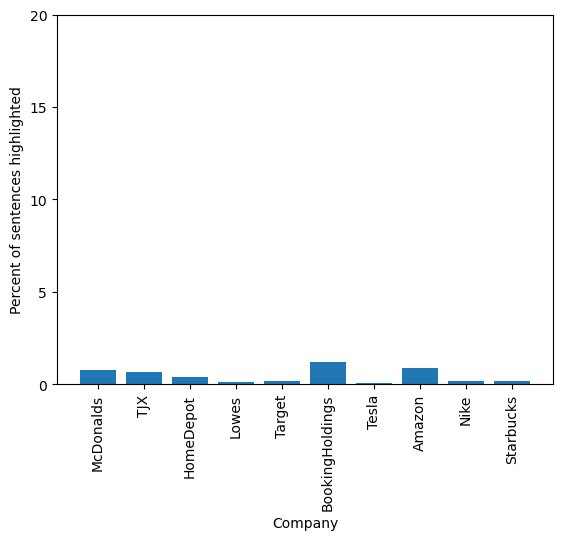

In [79]:
import matplotlib.pyplot as plt
import numpy as np
import glob
y = []

i = 0

for file in os.listdir(dir):
    y.append(100 * (rel_sent_list[i])/sentences_list[i])
    i = i+1

plt.bar(x_label, y, width = 0.8)
plt.xticks(rotation='vertical')
plt.xlabel("Company")
plt.ylabel("Percent of sentences highlighted")
plt.yticks(np.arange(0, 25, 5))
plt.show()

In [80]:
import pandas as pd

series = pd.Series(y)
series.describe()

count    10.000000
mean      0.463572
std       0.383975
min       0.076336
25%       0.176396
50%       0.298937
75%       0.729642
max       1.182894
dtype: float64

### Exporting and Saving Files 

In [81]:
#storing variable so they can be called between notebooks (for ML and aggregate work later on)

CONDIS_reltext = rel_text_df
CONDIS_alltext = all_text_df
CONDIS_stat = final_text_stat

%store CONDIS_reltext
%store CONDIS_alltext
%store CONDIS_stat

Stored 'CONDIS_reltext' (DataFrame)
Stored 'CONDIS_alltext' (DataFrame)
Stored 'CONDIS_stat' (DataFrame)
